In [2]:
!pip install pandas
!pip install xlrd

In [3]:
!pip install spacy
!pip install nltk

In [1]:
from spacy.cli import download
download("en_core_web_sm") #downloads the English model

✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [2]:
import pandas as pd

wiki_df = pd.read_excel('data/sorted_wikileaks_parsed.xlsx') #read data from excel sheet, store in DataFrame

In [3]:
wiki_df.head()

,PDF Path,Text
0,1.pdf,Pristina Airport – Possible administrative irr...
1,1.pdf,Investigative details\n\nIn his/her interviews...
2,2.pdf,The investigation conducted by the ITF clearly...
3,2.pdf,Documentation obtained by the ITF from the Pri...
4,2.pdf,"The ATCS Official stated that in 2002, he/she ..."


In [4]:
#check for missing values
print(wiki_df.isnull().sum())  # Count missing values

PDF Path    0
Text        0
dtype: int64


In [6]:
wiki_df = wiki_df.drop_duplicates() #remove duplicate rows

In [7]:
wiki_df['text_cleaned'] = wiki_df['Text'].str.lower() #convert to lowercase

In [8]:
#function to remove extra spaces
def clean_text(text):
    if isinstance(text, str):
        text = text.strip()  # Remove extra spaces
    return text

wiki_df['text_cleaned'] = wiki_df['Text'].apply(clean_text)#apply cleaning function


In [10]:
import spacy

In [11]:
#load spaCy model
nlp = spacy.load("en_core_web_sm")

In [12]:
#function for tokenisation
def tokenize_text(text):
    doc = nlp(text)
    return [token.text for token in doc]


In [13]:
wiki_df['tokens'] = wiki_df['text_cleaned'].apply(tokenize_text) #apply tokenisation function

In [14]:
from spacy import displacy

In [15]:
#function for extracting entities and visualise NER results
def extract_entities(text):
    if isinstance(text, str):  # Ensure text is a string
        
        doc = nlp(text)
        
        #extract named entities
        entities = [(ent.text, ent.label_) for ent in doc.ents]  # Extract entity and label
       
        #visualisation        
        spacy.displacy.render(doc, style="ent")
        
        return str(entities)  # Convert list to string for Excel storage
        
    return ""


In [16]:
#apply extract entities function 
wiki_df['named_entities'] = wiki_df['text_cleaned'].apply(extract_entities)


In [17]:
#dependency parsing
def dependency_parsing(text):
    if isinstance(text, str):  # Ensure text is a string
        
        doc = nlp(text)
        
        print(f"{'Node (from)-->':<15} {'Relation':^10} {'-->Node (to)':>15}\n")
        
        for token in doc:
            print("{:<15} {:^10} {:>15}".format(str(token.head.text), str(token.dep_), str(token.text)))
        displacy.render(doc, style='dep')

In [ ]:
wiki_df['dependencies'] = wiki_df['text_cleaned'].apply(dependency_parsing)

Node (from)-->   Relation     -->Node (to)

Airport          compound         Pristina
took              nsubj            Airport
Airport           punct                  –
irregularity       amod           Possible
irregularity       amod     administrative
took              nsubj       irregularity
irregularity       prep          regarding
procedures       compound           tender
regarding          pobj         procedures
procedures         acl           involving
involving          dobj             Vendor
Vendor            nummod                 1
Vendor              cc                 and
Allegation         nmod             Vendor
Vendor            nummod                 2
2                  dep                  


Two              compound       Allegation
Allegation         dep                  


companies         nummod               Two
Vendor             conj          companies
involving          prep               with
owner              det                 the
owner     

Node (from)-->   Relation     -->Node (to)

details            amod      Investigative
admitted          nsubj            details
details            dep                  


admitted           prep                 In
interviews         poss                his
interviews        punct                  /
interviews         poss                her
In                 pobj         interviews
interviews         acl           conducted
conducted          prep                 on
August           compound             31st
on                 pobj             August
August              cc                 and
September          amod               14th
August             conj          September
September         nummod              2004
admitted          punct                  ,
admitted          nsubj             Vendor
Vendor            nummod                 1
Vendor              cc                 and
Representative     nmod             Vendor
Representative   compound                2
Vendor    

Node (from)-->   Relation     -->Node (to)

investigation      det                 The
documented        nsubj      investigation
investigation      acl           conducted
conducted         agent                 by
ITF                det                 the
by                 pobj                ITF
documented        advmod           clearly
documented         ROOT         documented
failed             mark               that
Airport          compound        Prishtina
management       compound          Airport
failed            nsubj         management
documented        ccomp             failed
perform            aux                  to
failed            xcomp            perform
duties             poss              their
perform            dobj             duties
perform            prep                 in
in                 pobj         accordance
accordance         prep               with
principles         det                 the
principles         amod            general
with      

Node (from)-->   Relation     -->Node (to)

shows             nsubj      Documentation
Documentation      acl            obtained
obtained          agent                 by
ITF                det                 the
by                 pobj                ITF
obtained           prep               from
Airport            det                 the
Airport          compound        Prishtina
from               pobj            Airport
shows             advmod           clearly
shows              ROOT              shows
failed             mark               that
management       compound             ATCS
failed            nsubj         management
shows             ccomp             failed
introduce          aux                  to
failed            xcomp          introduce
failed            punct                  ,
failed              cc                  or
failed             conj            enforce
enforce           punct                  ,
enforce            conj              rules
rules     

Node (from)-->   Relation     -->Node (to)

Official           det                 The
Official         compound             ATCS
stated            nsubj           Official
stated             ROOT             stated
experienced        mark               that
experienced        prep                 in
in                 pobj               2002
experienced       punct                  ,
experienced     nsubjpass               he
he                punct                  /
he                appos                she
experienced      auxpass               was
experienced        neg                 not
experienced       advmod      sufficiently
stated            ccomp        experienced
experienced        prep                 in
management         amod          financial
in                 pobj         management
stated            punct                  ,
stated            advmod         therefore
hired             nsubj                 he
he                punct                  /
hired     

Node (from)-->   Relation     -->Node (to)

Official           det                 The
Official         compound             ATCS
indicated         nsubj           Official
indicated         advmod           further
indicated          ROOT          indicated
approved           mark               that
superiors          poss                his
superiors         punct                  /
superiors          poss                her
approved          nsubj          superiors
indicated         ccomp           approved
bills             predet               all
bills              det                 the
approved           dobj              bills
were              nsubj               that
bills             relcl               were
were               prep                 in
binders            det                 the
binders            amod              petty
binders          compound             cash
in                 pobj            binders
binders           punct                  ,
binders   

Node (from)-->   Relation     -->Node (to)

ITF                det                 The
interviewed       nsubj                ITF
show              ccomp        interviewed
Official           det                 the
Official         compound             ATCS
interviewed        dobj           Official
interviewed        prep                 on
occasions         nummod               two
on                 pobj          occasions
interviewed         cc                 and
interviewed        conj                 he
interviewed       punct                  /
acknowledged      nsubj                she
show              ccomp       acknowledged
cases              mark               that
acknowledged       dobj              cases
cases             nummod           46/2002
cases             punct                  ;
cases             appos            49/2002
49/2002           punct                  ;
49/2002            conj            55/2002
55/2002             cc                 and
55/2002   

Node (from)-->   Relation     -->Node (to)

Manager            det                 The
Manager          compound         Division
said              nsubj            Manager
said               ROOT               said
bring              mark               that
Official           det                 the
Official         compound             ATCS
bring             nsubj           Official
bring              aux               would
said              ccomp              bring
bring             dative                to
to                 pobj                him
bring             punct                  /
bring             dative               her
request            det                   a
bring              dobj            request
detail             prep                 in
in                 pobj              which
detail            nsubj                 he
he                punct                  /
/                 appos                she
detail             aux               would
request   

Node (from)-->   Relation     -->Node (to)

ITF                det                 The
interviewed       nsubj                ITF
interviewed        ROOT        interviewed
interviewed        dobj           Official
Official          nummod                 1
interviewed        prep                 at
Airport          compound        Prishtina
at                 pobj            Airport
interviewed       punct                  .
She                nmod                 He
He                punct                  /
stated            nsubj                She
stated             ROOT             stated
travelled          mark               that
travelled          prep                 in
in                 pobj                May
May               nummod              2002
travelled         nsubj                 he
travelled         punct                  /
travelled         nsubj                she
stated            ccomp          travelled
travelled          prep               with
Official  

Node (from)-->   Relation     -->Node (to)

INFORMATION      compound       BACKGROUND
INFORMATION        ROOT        INFORMATION
review             det                   A
revealed          nsubj             review
review             prep                 of
airport            det                 the
accounts           poss            airport
airport            case                 ’s
accounts         compound             bank
of                 pobj           accounts
accounts            cc                 and
accounts           conj          documents
documents          acl             related
related            prep                 to
operations       compound          airport
to                 pobj         operations
operations        punct                  ,
operations         conj          contracts
contracts         punct                  ,
contracts           cc                 and
matters            amod          financial
contracts          conj            matters
revealed  

Node (from)-->   Relation     -->Node (to)

IV                 ROOT                 IV
IV                punct                  .
DETAILS          compound    INVESTIGATIVE
focused         nsubjpass          DETAILS
DETAILS            dep                   

investigation      det                 The
investigation    compound              ITF
DETAILS           appos      investigation
focused          auxpass               was
focused            ROOT            focused
focused            prep                 on
examination        det                 the
on                 pobj        examination
examination        prep                 of
areas             nummod               two
areas              amod               main
of                 pobj              areas
areas             punct                  ;
arrangements       det                   a
a                 punct                  )
arrangements     compound           travel
areas             appos       arrangements
arrangemen

Node (from)-->   Relation     -->Node (to)

investigation      det                 The
investigation    compound              ITF
focused         nsubjpass    investigation
focused          auxpass               was
focused            ROOT            focused
focused            prep                 on
examination        det                 the
on                 pobj        examination
examination        prep                 of
areas             nummod               two
areas              amod               main
of                 pobj              areas
areas             punct                  ;
arrangements       det                   a
a                 punct                  )
arrangements     compound           travel
areas             appos       arrangements
arrangements        cc                 and
expenses         compound             cash
arrangements       conj           expenses
arrangements       acl             related
related            prep                 to
travel    

Node (from)-->   Relation     -->Node (to)

identified         prep             During
review             det                 the
During             pobj             review
review             prep                 of
documentation      amod          available
of                 pobj      documentation
identified        punct                  ,
investigators      det                 the
investigators    compound              ITF
identified        nsubj      investigators
identified         ROOT         identified
number             det                   a
identified         dobj             number
number             prep                 of
of                 pobj           problems
problems           acl             related
related            prep                 to
procedures         det                 the
procedures         amod           existing
to                 pobj         procedures
procedures          cc                 and
procedures         conj          practices
procedures

Node (from)-->   Relation     -->Node (to)

apply              prep               With
With               pobj            regards
regards            prep                 to
to                 pobj        performance
performance         cc                 and
performance        conj            conduct
performance        prep                 of
employees          det                 the
of                 pobj          employees
employees          prep                 of
of                 pobj                KTA
KTA               punct                  ,
Regulation         det                 the
Regulation         amod          following
Regulation       compound            UNMIK
apply             nsubj         Regulation
apply              aux               shall
apply              ROOT              apply
apply             punct                  :
:                  dep                  


No               compound            UNMIK
No               compound       Regulation
Regulation

Node (from)-->   Relation     -->Node (to)

ITF                det                 The
interviewed       nsubj                ITF
interviewed        ROOT        interviewed
Officer          compound          Finance
interviewed        dobj            Officer
Officer           nummod                 2
interviewed       punct                  ,
employed          advcl            working
working            prep                 at
Office             det                 the
Office           compound             ATCS
Office           compound          Finance
at                 pobj             Office
Office            punct                  ,
stated            nsubj                who
Office            relcl             stated
stated             dobj                 he
employed          punct                  /
employed        nsubjpass              she
employed           aux                 has
employed         auxpass              been
interviewed        conj           employed
employed  

Node (from)-->   Relation     -->Node (to)

ITF                det                 The
interviewed       nsubj                ITF
interviewed        ROOT        interviewed
interviewed        dobj           Official
Official          nummod                 4
interviewed        prep                 at
Airport            det                 the
Airport          compound         Pristina
at                 pobj            Airport
interviewed       punct                  .
4                  amod           Official
requested       nsubjpass                4
requested        auxpass               was
requested          ROOT          requested
review             aux                  to
requested         xcomp             review
files              amod            several
review             dobj              files
files              acl             related
related            prep                 to
travel           compound         business
to                 pobj             travel
travel    

Node (from)-->   Relation     -->Node (to)

4                  amod           Official
requested       nsubjpass                4
requested        auxpass               was
requested         advmod              also
requested          ROOT          requested
review             aux                  to
requested         xcomp             review
files              det                 the
review             dobj              files
files              acl               dated
dated              prep              after
July              nummod                01
after              pobj               July
July              nummod              2002
files             punct                  ,
01/2002            prep                 in
files              amod         particular
in                 pobj              files
requested          dep             01/2002
01/2002           punct                  ;
01/2002           appos            05/2002
05/2002           punct                  ;
05/2002   

Node (from)-->   Relation     -->Node (to)

Investigators    compound              ITF
interviewed       nsubj      Investigators
interviewed        ROOT        interviewed
Manager            det                 the
Manager          compound         Division
interviewed        dobj            Manager
interviewed        prep                 on
occasions         nummod               two
on                 pobj          occasions
interviewed         cc                 and
explained        npadvmod               he
explained         punct                  /
explained         nsubj                she
interviewed        conj          explained
were               mark               that
travel           compound            staff
expenses         compound           travel
were              nsubj           expenses
explained         ccomp               were
were              acomp               high
were               prep            because
because           pcomp                 of
necessity 

Node (from)-->   Relation     -->Node (to)

Officer          compound          Finance
confirmed         nsubj            Officer
Officer           nummod                 1
confirmed         advmod              also
confirmed          ROOT          confirmed
supervised         mark               that
Manager            det                 the
Manager          compound         Division
supervised        nsubj            Manager
Manager             cc                 and
Official           det                 the
Official         compound             ATCS
Manager            conj           Official
confirmed         ccomp         supervised
work               det                 the
supervised         dobj               work
work               prep                 of
Office             det                 the
Office           compound             ATCS
Office           compound          Finance
of                 pobj             Office
confirmed         punct                  .
indicated 

Node (from)-->   Relation     -->Node (to)

concluded         punct                  "
report             det                 The
report           compound       evaluation
concluded         nsubj             report
concluded         advmod              also
concluded          ROOT          concluded
has                mark               that
company            det                 the
has               nsubj            company
company           appos             Vendor
Vendor            nummod                 1
concluded         ccomp                has
manufacturer      nummod               one
has                dobj       manufacturer
has                prep                 in
in                 pobj               Peja
Peja              punct                  ,
offer             nsubj              which
offer              aux                  ca
offer              neg                 n’t
Peja              relcl              offer
quality            det                 the
quality   

Node (from)-->   Relation     -->Node (to)

entrusted         punct                  "
entrusted          prep              Until
end                det                 the
Until              pobj                end
end                prep                 of
of                 pobj               June
June              nummod              2002
entrusted         punct                  ,
entrusted       nsubjpass   responsibility
responsibility     prep                for
administration     det                 the
for                pobj     administration
administration     prep                 of
Airport            det                 the
Airport          compound         Pristina
of                 pobj            Airport
entrusted        auxpass               was
entrusted          ROOT          entrusted
entrusted          prep                 to
Pillar             det                 the
Administration   compound            Civil
Pillar           compound   Administration
to        

Node (from)-->   Relation     -->Node (to)

entrusted         punct                  "
entrusted          prep              Until
end                det                 the
Until              pobj                end
end                prep                 of
of                 pobj               June
June              nummod              2002
entrusted         punct                  ,
entrusted       nsubjpass   responsibility
responsibility     prep                for
administration     det                 the
for                pobj     administration
administration     prep                 of
Airport            det                 the
Airport          compound         Pristina
of                 pobj            Airport
entrusted        auxpass               was
entrusted          ROOT          entrusted
entrusted          prep                 to
Pillar             det                 the
Administration   compound            Civil
Pillar           compound   Administration
to        

Node (from)-->   Relation     -->Node (to)

alleged           punct                  "
alleged          npadvmod       Allegation
Allegation        nummod                 7
7                  dep                  


alleged           punct                  (
alleged         nsubjpass               It
alleged          auxpass                is
alleged            ROOT            alleged
purchased          mark               that
quantities        nummod               two
quantities         amod            further
quantities         amod              small
purchased       nsubjpass       quantities
quantities         prep                 of
of                 pobj           uniforms
quantities         prep                 in
sums               det                 the
in                 pobj               sums
sums               prep                 of
792                nmod                  €
of                 pobj                792
quantities          cc                 and
1,188     

Node (from)-->   Relation     -->Node (to)

stated            punct                  "
asked             advmod              When
stated            advcl              asked
placed            advmod               why
orders            nummod               two
placed          nsubjpass           orders
placed           auxpass              were
asked             ccomp             placed
placed             prep             within
month             nummod               one
within             pobj              month
month              prep                 of
of                 pobj                one
one                det             another
asked             punct                  ,
than              advmod            rather
,                   cc                than
than              pcomp           together
stated            punct                  ,
Official           det                 the
Official         compound             PEAP
stated            nsubj           Official
stated    

Node (from)-->   Relation     -->Node (to)

specify           punct                  "
specify            prep                 In
In                 pobj           addition
specify           punct                  ,
requests           det                 the
requests          nummod               two
specify           nsubj           requests
specify            ROOT            specify
be                 mark               that
shirts             det                 the
be                nsubj             shirts
be                 aux              should
specify           ccomp                 be
same               det                 the
be                 attr               same
same               prep                 as
shirts             det                 the
shirts             amod           previous
as                 pobj             shirts
shirts             prep                 of
workers            det                 the
workers            amod           existing
of        

Node (from)-->   Relation     -->Node (to)

conducted         punct                  "
investigation    compound      METHODOLOGY
METHODOLOGY        dep                  


investigation      det                This
conducted       nsubjpass    investigation
conducted        auxpass               was
conducted          ROOT          conducted
conducted          oprd           pursuant
pursuant           prep                 to
Decision         compound        Executive
to                 pobj           Decision
2003/16            det                  No
conducted        npadvmod          2003/16
conducted          prep                 on
establishment      det                 the
on                 pobj      establishment
establishment      prep                 of
Force              det                 the
Force            compound    Investigation
Force            compound             Task
of                 pobj              Force
conducted         punct                  .
investigat

Node (from)-->   Relation     -->Node (to)

dated             punct                  "
report             det                   A
evaluation       compound              bid
report           compound       evaluation
dated             nsubj             report
dated              ROOT              dated
December          nummod                 6
dated              dobj           December
December          nummod              2002
dated              conj          indicates
issued             mark               that
firms             nummod                 8
issued          nsubjpass            firms
issued           auxpass              were
indicates         ccomp             issued
issued             prep               with
with               pobj          documents
documents           cc                 and
bids              nummod                 4
submitted       nsubjpass             bids
submitted        auxpass              were
indicates         ccomp          submitted
dated     

Node (from)-->   Relation     -->Node (to)

investigation    compound      METHODOLOGY
METHODOLOGY        dep                  


investigation      det                This
conducted       nsubjpass    investigation
conducted        auxpass               was
conducted          ROOT          conducted
conducted          oprd           pursuant
pursuant           prep                 to
Decision         compound        Executive
to                 pobj           Decision
2003/16            det                  No
conducted        npadvmod          2003/16
conducted          prep                 on
establishment      det                 the
on                 pobj      establishment
establishment      prep                 of
Force              det                 the
Force            compound    Investigation
Force            compound             Task
of                 pobj              Force
conducted         punct                  .
investigators      det                 The
investigat

Node (from)-->   Relation     -->Node (to)

investigation    compound      METHODOLOGY
METHODOLOGY        dep                  


investigation      det                This
conducted       nsubjpass    investigation
conducted        auxpass               was
conducted          ROOT          conducted
conducted          oprd           pursuant
pursuant           prep                 to
Decision         compound        Executive
to                 pobj           Decision
2003/16            det                  No
conducted        npadvmod          2003/16
conducted          prep                 on
establishment      det                 the
on                 pobj      establishment
establishment      prep                 of
Force              det                 the
Force            compound    Investigation
Force            compound             Task
of                 pobj              Force
conducted         punct                  .
investigators      det                 The
investigat

Node (from)-->   Relation     -->Node (to)

arises            punct                  "
arises           npadvmod     INTRODUCTION
INTRODUCTION       dep                  


case               det                This
arises            nsubj               case
arises             ROOT             arises
arises             prep                out
out                prep                 of
report             det                  an
report           compound            audit
of                 pobj             report
report             acl               dated
February          nummod                28
dated            npadvmod         February
February          nummod              2003
dated              prep               into
statements         det                 the
statements         amod          financial
into               pobj         statements
statements         prep                 of
Airport          compound         Pristina
Airport          compound    International
of        

Node (from)-->   Relation     -->Node (to)

constitutes       punct                  "
INFORMATION        nmod         BACKGROUND
Airport          compound      INFORMATION
INFORMATION        dep                  


Airport          compound         Pristina
Airport          compound    International
constitutes       nsubj            Airport
constitutes        ROOT        constitutes
enterprise         det                   a
owned            npadvmod            state
enterprise         amod              owned
constitutes        dobj         enterprise
enterprise         prep              under
law                amod        Yugoslavian
under              pobj                law
constitutes       punct                  .
assets             det                 The
include           nsubj             assets
assets             prep                 of
airport            det                 the
of                 pobj            airport
include            ROOT            include
runways   

Node (from)-->   Relation     -->Node (to)

constitutes       punct                  "
INFORMATION        nmod         BACKGROUND
Airport          compound      INFORMATION
INFORMATION        dep                  


Airport          compound         Pristina
Airport          compound    International
constitutes       nsubj            Airport
constitutes        ROOT        constitutes
enterprise         det                   a
owned            npadvmod            state
enterprise         amod              owned
constitutes        dobj         enterprise
enterprise         prep              under
law                amod        Yugoslavian
under              pobj                law
constitutes       punct                  .
assets             det                 The
include           nsubj             assets
assets             prep                 of
airport            det                 the
of                 pobj            airport
include            ROOT            include
runways   

Node (from)-->   Relation     -->Node (to)

give              punct                  "
memorandum         det                  An
memorandum       compound      interoffice
give              nsubj         memorandum
memorandum         acl           providing
issues             det                  an
issues            punct                  “
issues             amod        outstanding
update            nsubj             issues
providing         ccomp             update
update             prep                 to
to                 pobj           Official
Official          nummod                 2
Official          punct                  ”
update            punct                  ,
update             prep               from
Official         compound             DOTI
from               pobj           Official
Official          nummod                 3
from               prep                 to
member           compound            Staff
to                 pobj             member
member    

Node (from)-->   Relation     -->Node (to)

were              punct                  "
were              nsubj         Allegation
Allegation        nummod                 2
Allegation          cc                   &
Allegation         conj                  3
were              punct                  :
:                  dep                  


were              punct                  (
were              advmod      Specifically
were              punct                  ,
were              nsubj              three
three              prep                 of
persons            det                 the
of                 pobj            persons
persons            prep                 on
committees         det                 the
opening          compound              bid
committee        compound          opening
committees         nmod          committee
committee           cc                 and
committee          conj         evaluation
on                 pobj         committees
were      

Node (from)-->   Relation     -->Node (to)

stated            punct                  "
asked             advmod              When
stated            advcl              asked
asked              prep              about
about              pobj               this
asked              prep                 in
in                 pobj          interview
stated            punct                  ,
Manager            det                 the
Manager          compound       Divisional
stated            nsubj            Manager
stated             ROOT             stated
stated            punct                  :
stated            punct                  “
appear             prep            Without
Without           pcomp             seeing
documents          det                 any
documents          amod              other
seeing             dobj          documents
Without           punct                  ,
appear             prep                 on
face               det                 the
on        

Node (from)-->   Relation     -->Node (to)

relates           punct                  "
DETAILS          compound    INVESTIGATION
"                  meta            DETAILS
DETAILS            dep                  


part               det                This
relates           nsubj               part
part               prep                 of
investigation      det                 the
of                 pobj      investigation
relates            ROOT            relates
relates            prep                 to
tender             det                   a
to                 pobj             tender
tender             prep                for
contract           det                   a
for                pobj           contract
contract           prep                for
extension          det                 the
for                pobj          extension
extension          prep                 of
Apron              det                 the
Terminal         compound            Cargo
Apron     

Node (from)-->   Relation     -->Node (to)

notes             punct                  "
notes              prep                 At
At                 pobj          paragraph
At                 pobj                  4
4                  prep                 of
report             det                 the
evaluation       compound            Cargo
Extension        compound            Apron
evaluation       compound        Extension
report           compound       evaluation
of                 pobj             report
report             acl               dated
August            nummod                 2
dated            npadvmod           August
August            nummod              2001
notes             punct                  ,
committee          det                 the
notes             nsubj          committee
notes              ROOT              notes
include            mark               that
documents          det                 the
documents        compound          bidding
include   

Node (from)-->   Relation     -->Node (to)

entrusted         punct                  "
entrusted          prep              Until
end                det                 the
Until              pobj                end
end                prep                 of
of                 pobj               June
June              nummod              2002
entrusted         punct                  ,
entrusted       nsubjpass   responsibility
responsibility     prep                for
administration     det                 the
for                pobj     administration
administration     prep                 of
Airport            det                 the
Airport          compound         Pristina
of                 pobj            Airport
entrusted        auxpass               was
entrusted          ROOT          entrusted
entrusted          prep                 to
Pillar             det                 the
Administration   compound            Civil
Pillar           compound   Administration
to        

Node (from)-->   Relation     -->Node (to)

conducted         punct                  "
investigation    compound      METHODOLOGY
METHODOLOGY        dep                  


investigation      det                This
conducted       nsubjpass    investigation
conducted        auxpass               was
conducted          ROOT          conducted
conducted          oprd           pursuant
pursuant           prep                 to
Decision         compound        Executive
to                 pobj           Decision
2003/16            det                  No
conducted        npadvmod          2003/16
conducted          prep                 on
establishment      det                 the
on                 pobj      establishment
establishment      prep                 of
Force              det                 the
Force            compound    Investigation
Force            compound             Task
of                 pobj              Force
conducted         punct                  .
investigat

Node (from)-->   Relation     -->Node (to)

Allegation        punct                  "
Allegation         ROOT         Allegation
Allegation        nummod                 4
Allegation        punct                  :
:                  dep                  


Allegation        punct                  (
Allegation        advmod      Specifically
Allegation        punct                  ,
produced           mark               that
Vendor             det                 the
produced          nsubj             Vendor
Allegation        relcl           produced
results            poss                its
results            amod                own
results          compound             test
produced           dobj            results
confirm            aux                  to
produced          advcl            confirm
quality            det                 the
confirm            dobj            quality
quality            prep                 of
work               poss                its
work      

Node (from)-->   Relation     -->Node (to)

explained         punct                  "
explained         nsubj               DOTI
explained         nsubj           Official
Official          nummod                 2
explained          ROOT          explained
taken              mark               that
details            det                 the
details            amod          technical
taken           nsubjpass          details
details            prep                 of
project            det                 the
Apron            compound            Cargo
project          compound            Apron
project          compound        extension
of                 pobj            project
taken            auxpass              were
explained         ccomp              taken
taken              prep               from
study              det                 the
terminal         compound            cargo
study            compound         terminal
from               pobj              study
study     

Node (from)-->   Relation     -->Node (to)

is                punct                  "
Official         compound             DOTI
is                nsubj           Official
Official          nummod                 2
is                 ROOT                 is
responsible       advmod         primarily
is                acomp        responsible
responsible        prep                for
shortcomings       det                 the
for                pobj       shortcomings
shortcomings       prep                 in
documents          det                 the
documents        compound           tender
in                 pobj          documents
bear               mark           although
bear              punct                  ,
Official         compound             DOTI
bear              nsubj           Official
Official          nummod                 1
Official            cc                 and
CPE                det                 the
Official           conj                CPE
bear      

Node (from)-->   Relation     -->Node (to)

entrusted          prep              Until
end                det                 the
Until              pobj                end
end                prep                 of
of                 pobj               June
June              nummod              2002
entrusted         punct                  ,
entrusted       nsubjpass   responsibility
responsibility     prep                for
administration     det                 the
for                pobj     administration
administration     prep                 of
Airport            det                 the
Airport          compound         Pristina
of                 pobj            Airport
entrusted        auxpass               was
entrusted          ROOT          entrusted
entrusted          prep                 to
Pillar             det                 the
Administration   compound            Civil
Pillar           compound   Administration
to                 pobj             Pillar
Pillar    

Node (from)-->   Relation     -->Node (to)

METHODOLOGY        ROOT        METHODOLOGY
investigation      det                This
conducted       nsubjpass    investigation
conducted        auxpass               was
METHODOLOGY       ccomp          conducted
conducted          oprd           pursuant
pursuant           prep                 to
Decision         compound        Executive
to                 pobj           Decision
2003/16            det                  No
2003/16            ROOT            2003/16
2003/16            prep                 on
establishment      det                 the
on                 pobj      establishment
establishment      prep                 of
Force              det                 the
Force            compound    Investigation
Force            compound             Task
of                 pobj              Force
2003/16           punct                  .
investigators      det                 The
investigators    compound              ITF
conducted 

Node (from)-->   Relation     -->Node (to)

Staff            compound              Non
member           compound            Staff
statements         nmod             member
member            nummod                 1
member             case                 ’s
disclosed         nsubj         statements
statements         acl            provided
provided           prep                 to
Investigators      det                 the
Investigators    compound              ITF
to                 pobj      Investigators
statements        punct                  ,
disclosed          ROOT          disclosed
cases              det                 the
cases              amod          following
following          dep                    
cases             nummod               two
cases              amod           distinct
disclosed          dobj              cases
cases             punct                  :
:                  dep                  


A                compound             Case
said      

Node (from)-->   Relation     -->Node (to)

Staff            compound              Non
member           compound            Staff
statements         nmod             member
member            nummod                 1
member             case                 ’s
disclosed         nsubj         statements
statements         acl            provided
provided           prep                 to
Investigators      det                 the
Investigators    compound              ITF
to                 pobj      Investigators
statements        punct                  ,
stated            ccomp          disclosed
cases              det                 the
cases              amod          following
following          dep                    
cases             nummod               two
cases              amod           distinct
disclosed          dobj              cases
stated            punct                  :
:                  dep                  


B                compound             Case
B         

Node (from)-->   Relation     -->Node (to)

Staff            compound              Non
member           compound            Staff
statements         nmod             member
member            nummod                 1
member             case                 ’s
disclosed         nsubj         statements
statements         acl            provided
provided           prep                 to
Investigators      det                 the
Investigators    compound              ITF
to                 pobj      Investigators
statements        punct                  ,
alleges           ccomp          disclosed
cases              det                 the
cases              amod          following
cases             nummod               two
cases              amod           distinct
disclosed          dobj              cases
disclosed         punct                  :
A                compound             Case
alleges           nsubj                  A
alleges            prep                 On
July      

Node (from)-->   Relation     -->Node (to)

Staff            compound              Non
member           compound            Staff
statements         nmod             member
member            nummod                 1
member             case                 ’s
disclosed         nsubj         statements
statements         acl            provided
provided           prep                 to
Investigators      det                 the
Investigators    compound              ITF
to                 pobj      Investigators
statements        punct                  ,
told              ccomp          disclosed
cases              det                 the
cases              amod          following
cases             nummod               two
cases              amod           distinct
disclosed          dobj              cases
disclosed         punct                  :
told              nsubj               Case
member             det                   A
Staff            compound              Non
member    

Node (from)-->   Relation     -->Node (to)

dated             punct                  "
Agency             nmod         Background
Background          cc                 and
Background         conj        Allegations
Agency           compound                A
Agency           compound           Kosovo
Agency           compound            Trust
dated             nsubj             Agency
Agency            punct                  (
Unit               nmod                KTA
Unit              punct                  )
Audit            compound         Internal
Unit             compound            Audit
Agency            appos               Unit
Unit              punct                  (
Unit              appos                IAU
Unit              punct                  )
Memorandum       compound         Internal
Agency            appos         Memorandum
dated              ROOT              dated
October           nummod                 4
dated            npadvmod          October
October   

Node (from)-->   Relation     -->Node (to)

Unit               nmod         Background
Background          cc                 and
Background         conj        Allegations
Agency           compound                A
Agency           compound           Kosovo
Agency           compound            Trust
Background         conj             Agency
Agency            punct                  (
Agency            appos                KTA
Agency            punct                  )
Audit            compound         Internal
Unit             compound            Audit
dated             nsubj               Unit
Unit              punct                  (
Unit              appos                IAU
IAU               punct                  )
Memorandum       compound         Internal
Unit              appos         Memorandum
dated              ROOT              dated
October           nummod                 4
dated            npadvmod          October
October           nummod              2004
dated     

Node (from)-->   Relation     -->Node (to)

provided          punct                  "
provided        nsubjpass       Allegation
Allegation         dep                  


Allegation         prep                 In
In                 pobj               July
July              nummod              2004
provided          punct                  ,
ITF                det                 the
ITF                nmod      Investigation
Force            compound             Task
ITF                nmod              Force
ITF               punct                  (
provided        nsubjpass              ITF
ITF               punct                  )
provided         auxpass               was
provided           ROOT           provided
provided           prep               with
copy               det                   a
with               pobj               copy
copy               prep                 of
letter             det                   a
of                 pobj             letter
letter    

Node (from)-->   Relation     -->Node (to)

is                punct                  "
Airport          compound       Background
Background         dep                  


Airport          compound         Pristina
is                nsubj            Airport
is                 ROOT                 is
Airline            det                 the
cargo              poss            Airline
Airline            case                 ’s
handling         npadvmod            cargo
is                advcl           handling
handling           dobj              agent
agent              prep                for
imports            det                both
for                pobj            imports
imports             cc                 and
imports            conj            exports
handling            cc                 and
Airline            det                 the
is                nsubj            Airline
is                 conj                 is
State              det                 the
State     

Node (from)-->   Relation     -->Node (to)

OIOS               nmod                 ID
OIOS              punct                  /
requested         nsubj               OIOS
requested          ROOT          requested
officer          compound              DRA
officer          compound        logistics
requested          dobj            officer
requested        npadvmod                2
review             aux                  to
requested         advcl             review
bid                det                each
bid                amod         individual
review             dobj                bid
review              cc                 and
explain            aux                  to
review             conj            explain
annotations        poss                his
annotations       punct                  /
annotations        poss                her
explain            dobj        annotations
requested         punct                  .
officer          compound              DRA
officer   

Node (from)-->   Relation     -->Node (to)

stated             prep                 In
In                 pobj              terms
terms              prep                 of
criteria           det                 the
selection        compound         priority
criteria         compound        selection
of                 pobj           criteria
criteria           prep                 of
panel              det                 the
panel            compound       evaluation
of                 pobj              panel
panel             punct                  ,
officer          compound              DRA
officer          compound        logistics
stated            nsubj            officer
officer           nummod                 2
stated             ROOT             stated
advised            mark               that
DRA                det                 the
advised           nsubj                DRA
advised            aux                 had
stated            ccomp            advised
advised   

Node (from)-->   Relation     -->Node (to)

spoke              prep                 In
In                 pobj              order
find               aux                  to
order              acl                find
find               prt                 out
selected          advmod               why
bidder             det                 the
bidder             amod             lowest
selected        nsubjpass           bidder
bidder            punct                  ,
bidder            appos             Vendor
Vendor            nummod                 1
bidder            punct                  ,
selected         auxpass               was
selected          advmod             still
selected           neg                 not
find              ccomp           selected
spoke             punct                  ,
OIOS               nmod                 ID
OIOS              punct                  /
spoke             nsubj               OIOS
spoke              ROOT              spoke
spoke     

Node (from)-->   Relation     -->Node (to)

complainant        det                 The
raised            nsubj        complainant
raised             ROOT             raised
issues            nummod               two
issues             amod               main
raised             dobj             issues
issues            punct                  :
raised            advmod           firstly
raised            punct                  ,
was                mark               that
bid                det                 the
was               nsubj                bid
bid                acl           submitted
submitted         agent                 by
by                 pobj             Vendor
Vendor            nummod                 1
was               punct                  ,
raised            ccomp                was
bid                det                 the
bid                amod             lowest
was                attr                bid
offered            mark            because
offered   

Node (from)-->   Relation     -->Node (to)

prepared           prep                 In
2002               amod               late
In                 pobj               2002
prepared          punct                  ,
consultant         det                 the
consultant       compound              EAR
prepared          nsubj         consultant
prepared           ROOT           prepared
specifications     det                 the
specifications     amod          technical
prepared           dobj     specifications
specifications     prep                for
PDAs               det                 the
for                pobj               PDAs
PDAs               acl               based
based              prep                 on
proposal           det                 the
on                 pobj           proposal
proposal           prep                 in
report             poss           SPUVESEK
SPUVESEK           case                 ’s
report           compound        inception
in        

Node (from)-->   Relation     -->Node (to)

evidence           det                 The
confirms          nsubj           evidence
evidence           acl             adduced
adduced           agent                 by
investigation      det                 the
by                 pobj      investigation
confirms          advmod           further
confirms           ROOT           confirms
conform            mark               that
PDAs               det                 the
conform           nsubj               PDAs
PDAs               acl             offered
offered           agent                 by
by                 pobj             Vendor
Vendor            nummod                 1
conform            aux                 did
conform            neg                 not
confirms          ccomp            conform
conform            prep                 to
specifications     det                 the
specifications     amod          technical
to                 pobj     specifications
specificat

Node (from)-->   Relation     -->Node (to)

review             det                  An
review             amod           internal
II               compound           Pillar
review           compound               II
highlighted       nsubj             review
review             prep                 by
Review             det                 the
Review           compound           Policy
by                 pobj             Review
Review              cc                 and
Oversight        compound         Internal
Unit             compound        Oversight
Review             conj               Unit
Unit              punct                  (
Unit              appos               PRIO
Unit              punct                  )
highlighted        ROOT        highlighted
irregularities     amod           possible
highlighted        dobj     irregularities
highlighted        prep                 in
report             poss                its
report             amod        preliminary
in        

Node (from)-->   Relation     -->Node (to)

showed             prep                 In
report             det                 the
report             amod        preliminary
report           compound             PRIO
In                 pobj             report
showed            punct                  ,
estimates          det                 the
estimates        compound            price
showed            nsubj          estimates
stated             mark                 as
estimates         advcl             stated
stated             prep                 in
consultant         det                 the
consultant       compound              EAR
report             poss         consultant
consultant         case                 ’s
report           compound        inception
in                 pobj             report
showed             ROOT             showed
models            nummod              five
models             amod          different
models           compound              PDA
showed    

Node (from)-->   Relation     -->Node (to)

Assistant        compound          Finance
claimed           nsubj          Assistant
Assistant         nummod                 1
claimed            ROOT            claimed
noticed           nsubj                 he
noticed            aux                 had
noticed            neg                 not
claimed           ccomp            noticed
footer             det                 the
noticed            dobj             footer
noticed            prep                 on
on                 pobj               them
claimed           punct                  .
asked             advmod              When
OIOS               nmod                 ID
OIOS              punct                  /
asked             nsubj               OIOS
disclaimed        advcl              asked
have              advmod               why
photocopies        det                 the
have              nsubj        photocopies
photocopies        prep                 of
faxes     

Node (from)-->   Relation     -->Node (to)

wrote             punct                  "
wrote             nsubj             Emails
Emails             prep                 by
member             det                 the
member           compound            staff
by                 pobj             member
Emails             prep                 to
Mzumara          compound              Mr.
to                 pobj            Mzumara
Mzumara           punct                  ,
Mzumara           appos                OIC
OIC               punct                  ,
OIC                conj                SRO
OIC               punct                  ,
Mzumara           appos             Lusaka
Lusaka             dep                   

wrote              prep                 On
January           nummod                29
On                 pobj            January
January           nummod              2003
wrote             punct                  ,
member             det                 the
member    

Node (from)-->   Relation     -->Node (to)

revealed          punct                  "
revealed           prep             During
course             det                 the
During             pobj             course
course             prep                 of
investigation      det                 the
of                 pobj      investigation
revealed          punct                  ,
revealed        nsubjpass               it
revealed         auxpass               was
revealed           ROOT           revealed
sent               mark               that
sent               prep                 on
January           nummod                26
on                 pobj            January
January           nummod              2003
sent              punct                  ,
person             det                  an
person             amod          anonymous
sent              nsubj             person
person            punct                  ,
person             acl               using
identities

Node (from)-->   Relation     -->Node (to)

received          punct                  "
Division         compound     INTRODUCTION
INTRODUCTION       dep                  


Division           det                 The
Division         compound   Investigations
received          nsubj           Division
Division           prep                 of
Office             det                 the
of                 pobj             Office
Office             prep                 of
Services         compound         Internal
Services         compound        Oversight
of                 pobj           Services
Services          punct                  (
Services          appos               OIOS
Division          punct                  )
received           ROOT           received
emails             amod            several
received           dobj             emails
emails             acl                sent
sent              dative                to
to                 pobj            persons
persons   

Node (from)-->   Relation     -->Node (to)

provides          punct                  "
Regulation       compound       APPLICABLE
APPLICABLE       npadvmod              LAW
LAW                dep                  


provides          nsubj         Regulation
Regulation        nummod               1.2
i                 punct                  (
provides          nsubj                  i
i                 punct                  )
i                  prep                 of
Regulations        det                 the
Regulations      compound            Staff
of                 pobj        Regulations
provides           ROOT           provides
exercise           mark               that
exercise          punct                  “
members          compound            Staff
exercise          nsubj            members
exercise           aux               shall
provides          ccomp           exercise
discretion         det                 the
discretion         amod             utmost
exercise  

Node (from)-->   Relation     -->Node (to)

email             punct                  "
DETAILS            amod      INVESTIGATIVE
email              nmod            DETAILS
DETAILS            dep                  


email             punct                  “
Abebe            compound            Hiwot
email              nmod              Abebe
Abebe             punct                  ”
revealed        nsubjpass            email
email              prep                 of
January           nummod                26
of                 pobj            January
January           nummod              2003
2003               dep                  


revealed           prep             During
course             det                 the
During             pobj             course
course             prep                 of
investigation      det                 the
of                 pobj      investigation
revealed          punct                  ,
revealed        nsubjpass               it
revealed  

Node (from)-->   Relation     -->Node (to)

told              punct                  "
DETAILS          compound               V.
DETAILS          compound    INVESTIGATIVE
told              nsubj            DETAILS
DETAILS            dep                  


interviewed       advmod              When
told              dative       interviewed
Officer            det                 the
Officer          compound             ACGD
told              nsubj            Officer
told               ROOT               told
OIOS               nmod                 ID
OIOS              punct                  /
told               dobj               OIOS
asked              mark               that
asked             nsubj           Official
Official          nummod                 2
asked              aux                 had
told              ccomp              asked
asked              dobj                him
pay                aux                  to
asked             xcomp                pay
expenses  

Node (from)-->   Relation     -->Node (to)

explained         punct                  "
DETAILS          compound               V.
DETAILS          compound    INVESTIGATIVE
explained         nsubj            DETAILS
DETAILS            dep                  


Officer            det                 The
Officer          compound             ACGD
DETAILS           appos            Officer
explained          ROOT          explained
discrepancies      det               these
explained          dobj      discrepancies
explained          prep                 by
by                pcomp         suggesting
tampered           mark               that
employee           det                   a
employee         compound             bank
tampered          nsubj           employee
tampered           aux               might
tampered           aux                have
suggesting        ccomp           tampered
tampered           prep               with
list               det                 the
list      

Node (from)-->   Relation     -->Node (to)

shows             punct                  "
evidence           det                 The
shows             nsubj           evidence
evidence           acl             adduced
adduced            prep                for
for                pobj         allegation
allegation        nummod                 3
shows              ROOT              shows
received           mark               that
Member           compound             UNEP
Member           compound            Staff
received          nsubj             Member
Member            nummod                 2
shows             ccomp           received
appointment        det                  an
received           dobj        appointment
appointment        prep               with
with               pobj               PCAU
received           prep                 in
in                 pobj                May
May               nummod              2000
shows             punct                  ,
a         

Node (from)-->   Relation     -->Node (to)

received          punct                  "
Division           det                 The
Division         compound   Investigations
received          nsubj           Division
Division           prep                 of
Office             det                 the
of                 pobj             Office
Office             prep                 of
Services         compound         Internal
Services         compound        Oversight
of                 pobj           Services
OIOS              punct                  (
OIOS               nmod                 ID
OIOS              punct                  /
Services          appos               OIOS
Division          punct                  )
received           ROOT           received
report             det                   a
received           dobj             report
report             prep                 of
wrongdoing         amod            alleged
of                 pobj         wrongdoing
wrongdoing

Node (from)-->   Relation     -->Node (to)

shows             punct                  "
evidence           det                 The
shows             nsubj           evidence
evidence           acl             adduced
adduced            prep                for
for                pobj         allegation
allegation        nummod                 1
shows              ROOT              shows
have               mark               that
Member           compound             UNEP
Member           compound            Staff
have              nsubj             Member
Member            nummod                 2
Member            punct                  ,
Member              cc                 and
PCAU               nmod               UNEP
PCAU              punct                  /
Consultant       compound             PCAU
Member             conj         Consultant
have               aux                 did
have               neg                 not
have               prep                 at
time      

Node (from)-->   Relation     -->Node (to)

learned           punct                  "
learned            prep             During
course             det                 the
During             pobj             course
course             prep                 of
investigation      det                 the
of                 pobj      investigation
learned           punct                  ,
OIOS               nmod                 ID
OIOS              punct                  /
learned           nsubj               OIOS
learned            ROOT            learned
received           mark               that
company            det                 the
company            amod             former
received          nsubj            company
learned           ccomp           received
received           dobj          contracts
contracts           cc                 and
contracts          conj         extensions
contracts          prep                 of
of                 pobj          contracts
contracts 

Node (from)-->   Relation     -->Node (to)

entrusted         punct                  "
entrusted          prep              Until
end                det                 the
Until              pobj                end
end                prep                 of
of                 pobj               June
June              nummod              2002
entrusted         punct                  ,
entrusted       nsubjpass   responsibility
responsibility     prep                for
administration     det                 the
for                pobj     administration
administration     prep                 of
Airport            det                 the
Airport          compound         Pristina
of                 pobj            Airport
entrusted        auxpass               was
entrusted          ROOT          entrusted
entrusted          prep                 to
Pillar             det                 the
Administration   compound            Civil
Pillar           compound   Administration
to        

Node (from)-->   Relation     -->Node (to)

know              punct                  "
know              advmod           Further
know              punct                  ,
know               prep                 in
in                 pobj         interviews
interviews         prep               with
ITF                det                 the
with               pobj                ITF
know              punct                  ,
personnel          det                 the
personnel        compound          Airport
know              nsubj          personnel
know               aux                 did
know               neg                 not
know               ROOT               know
required           mark            whether
ICAA               det                 the
required        nsubjpass             ICAA
required         auxpass               was
know              ccomp           required
follow             aux                  to
required          xcomp             follow
protocols 

Node (from)-->   Relation     -->Node (to)

Violations         amod            Alleged
Violations         ROOT         Violations
Violations         prep                 of
Insurance        compound      Procurement
Insurance        compound       Procedures
Insurance         punct                  -
of                 pobj          Insurance
Insurance         punct                  (
Insurance         appos                 No
Insurance         appos                  .
Insurance         nummod           0216104
Violations        punct                  )
)                  dep                  


received           prep                 In
In                 pobj              April
April             nummod              2004
received          punct                  ,
ITF                det                 the
ITF                nmod      Investigation
Force              nmod               Task
ITF                nmod              Force
ITF               punct                  (
received  

Node (from)-->   Relation     -->Node (to)

misappropriation    amod            Alleged
misappropriation    ROOT    misappropriation
misappropriation    prep                 of
of                 pobj              funds
misappropriation   punct                  –
misappropriation   appos            Manager
Manager           punct                  (
No               compound             Case
Manager           appos                 No
Manager           punct                  .
Manager           appos             050/04
Manager           punct                  )
)                  dep                  


Force              det                 The
Force            compound    Investigation
Force            compound             Task
investigating     nsubj              Force
ITF               punct                  (
Force             appos                ITF
Force             punct                  )
investigating      aux                 has
investigating      aux                been
inve

Node (from)-->   Relation     -->Node (to)

made              punct                  "
made               prep                 In
memo               det                 the
memo             compound              IAU
In                 pobj               memo
made              punct                  ,
made            nsubjpass        reference
made             auxpass                is
made               ROOT               made
made               prep                 to
letter             det                   a
to                 pobj             letter
letter             prep                 of
of                 pobj          complaint
letter             acl               dated
04                nummod                28
06                punct                  -
28                 prep                 06
04                punct                  -
dated              dobj                 04
dated              prep               from
from               pobj             Vendor
Vendor    

Node (from)-->   Relation     -->Node (to)

managed           punct                  "
Officer          compound    Investigation
Officer          compound          Details
Details            dep                  


Officer          compound      Procurement
managed           nsubj            Officer
Officer           nummod                 1
managed            ROOT            managed
tender             det                 the
tender             amod        competitive
managed            dobj             tender
tender             prep                for
supply             det                 the
for                pobj             supply
supply             prep                 of
of                 pobj           uniforms
managed           punct                  .
In                 ROOT                 In
In                 pobj           addition
addition           prep                 to
to                 pobj             Vendor
Vendor            nummod                 1
Vendor    

Node (from)-->   Relation     -->Node (to)

explained         punct                  "
explained         nsubj         Allegation
Allegation        nummod                 2
Allegation        punct                  :
replaced           mark               that
Officer          compound      Procurement
replaced          nsubj            Officer
Officer           nummod                 1
Allegation         acl            replaced
member             det                   a
replaced           dobj             member
member             prep                 of
Officer            det                 the
Evaluation       compound              Bid
Committee        compound       Evaluation
Officer          compound        Committee
Committee          dep                  


Officer          compound      Procurement
of                 pobj            Officer
Officer           nummod                 1
explained          ROOT          explained
explained          prep                 to
ITF       

Node (from)-->   Relation     -->Node (to)

said              punct                  "
asked             advmod              When
said              advcl              asked
asked             agent                 by
ITF                det                 the
by                 pobj                ITF
substantiate       aux                  to
asked             xcomp       substantiate
allegation         poss                his
allegation        punct                  /
allegation         poss                her
substantiate       dobj         allegation
accepted           mark               that
Officer          compound      Procurement
accepted          nsubj            Officer
Officer           nummod                 1
Officer             cc                 and
Officer            det                 the
Officer          compound          Finance
Officer            conj            Officer
accepted           aux                 had
allegation         acl            accepted
accepted  

Node (from)-->   Relation     -->Node (to)

entrusted         punct                  "
entrusted          prep              Until
end                det                 the
Until              pobj                end
end                prep                 of
of                 pobj               June
June              nummod              2002
entrusted         punct                  ,
entrusted       nsubjpass   responsibility
responsibility     prep                for
administration     det                 the
for                pobj     administration
administration     prep                 of
Airport            det                 the
Airport          compound         Pristina
of                 pobj            Airport
entrusted        auxpass               was
entrusted          ROOT          entrusted
entrusted          prep                 to
Pillar             det                 the
Administration   compound            Civil
Pillar           compound   Administration
to        

Node (from)-->   Relation     -->Node (to)

III               punct                  "
III                ROOT                III
III               punct                  .
METHODOLOGY        ROOT        METHODOLOGY
METHODOLOGY        dep                  


investigation      det                This
conducted       nsubjpass    investigation
conducted        auxpass               was
conducted          ROOT          conducted
conducted          oprd           pursuant
pursuant           prep                 to
Decision         compound        Executive
to                 pobj           Decision
2003/16            det                  No
conducted        npadvmod          2003/16
conducted          prep                 on
establishment      det                 the
on                 pobj      establishment
establishment      prep                 of
Force              det                 the
Force            compound    Investigation
Force            compound             Task
of        

Node (from)-->   Relation     -->Node (to)

granted           punct                  "
denied            nsubj        Conclusions
Conclusions        dep                  


denied             mark           Although
Official         compound             PEAP
denied            nsubj           Official
Official           prep                 as
official           det                 the
official           amod        responsible
as                 pobj           official
official           prep                 at
time               det                that
at                 pobj               time
granted           ccomp             denied
requested          mark               that
requested         nsubj                 he
requested         nsubj                  /
/                 appos                she
requested          aux                 had
denied            ccomp          requested
support            nmod             Vendor
Vendor              cc                   2
support   

Node (from)-->   Relation     -->Node (to)

official         compound       Allegation
Allegation         dep                  


official           det                  An
supported         nsubj           official
official           prep                 of
company            det                   a
company            amod                non
company            amod                  -
company            amod            Airport
company            amod            related
of                 pobj            company
official          punct                  ,
supported          ROOT          supported
process            det                 the
process          compound      procurement
supported          dobj            process
process            prep                for
supply             det                 the
for                pobj             supply
supply             prep                 of
System             det                 the
System           compound             Flat
Display   

Node (from)-->   Relation     -->Node (to)

interviewed       punct                  "
details            amod      Investigative
interviewed     nsubjpass          details
details            dep                  


Engineer           det                 The
Engineer         compound          Airport
details           appos           Engineer
interviewed      auxpass               was
is                ccomp        interviewed
interviewed        prep                 on
October           nummod                11
on                 pobj            October
October           nummod              2004
interviewed       punct                  ,
interviewed        prep                 as
as                 pobj                 he
interviewed       punct                  /
is                nsubj                she
is                 ROOT                 is
person             det                 the
person             amod        responsible
is                 attr             person
suggest   

Node (from)-->   Relation     -->Node (to)

Airport           punct                  "
Airport          compound         Pristina
Airport            ROOT            Airport
Airport           punct                  –
irregularity       amod            Alleged
irregularity       amod     administrative
Airport           appos       irregularity
irregularity       prep          regarding
Allegation         det                  an
Allegation       compound                X
Allegation        punct                  -
Tender           compound              RAY
Allegation       compound           Tender
Tender             dep                  


regarding          pobj         Allegation
Allegation         dep                  


Airport            prep                 On
29th               det                 the
On                 pobj               29th
On                 pobj                May
May               nummod              2003
Airport           punct                  ,
Manager   

Node (from)-->   Relation     -->Node (to)

III               punct                  "
III                ROOT                III
III               punct                  .
DETAILS            amod      INVESTIGATIVE
DETAILS            ROOT            DETAILS
DETAILS            dep                  


charges            det                 The
scrutinized     nsubjpass          charges
charges           appos         themselves
charges           punct                  ,
calculated         mark                 as
charges           advcl         calculated
calculated        agent                 by
Department         det                 the
Services         compound          Airport
Services         compound         Handling
Department       compound         Services
by                 pobj         Department
Department         prep                for
flights          compound          Airline
for                pobj            flights
charges           punct                  ,
scrutinize

Node (from)-->   Relation     -->Node (to)

FINDINGS          punct                  "
FINDINGS           nmod                 IV
IV                punct                  .
is                nsubj           FINDINGS
FINDINGS            cc                 AND
FINDINGS           conj        CONCLUSIONS
CONCLUSIONS        dep                  


is                 expl              There
is                 ROOT                 is
evidence           det                  no
is                 attr           evidence
sought             mark               that
Airline            det                 the
sought            nsubj            Airline
sought             aux                have
evidence           acl              sought
avoid              aux                  to
sought            xcomp              avoid
charges            det                 any
avoid              dobj            charges
charges            acl              levied
levied            agent                 by
Airport   

Node (from)-->   Relation     -->Node (to)

III               punct                  "
III                ROOT                III
III               punct                  .
DETAILS          compound    INVESTIGATIVE
reviewed          nsubj            DETAILS
DETAILS            dep                  


ITF                det                 The
reviewed          nsubj                ITF
reviewed           ROOT           reviewed
procedures         det                 the
procedures         amod       conventional
procedures         nmod              check
check             punct                  -
check              prt                  in
reviewed           dobj         procedures
procedures         prep                 at
Airport            det                 the
Airport          compound         Pristina
at                 pobj            Airport
reviewed            cc                 and
reviewed           conj          confirmed
complied          nsubj               they
confirmed 

Node (from)-->   Relation     -->Node (to)

III               punct                  "
III                ROOT                III
III               punct                  .
DETAILS          compound    INVESTIGATIVE
reviewed          nsubj            DETAILS
DETAILS            dep                  


ITF                det                 The
reviewed          nsubj                ITF
reviewed           ROOT           reviewed
procedures         det                 the
procedures         amod       conventional
procedures         nmod              check
check             punct                  -
check              prt                  in
reviewed           dobj         procedures
procedures         prep                 at
Airport            det                 the
Airport          compound         Pristina
at                 pobj            Airport
reviewed            cc                 and
reviewed           conj          confirmed
complied          nsubj               they
confirmed 

Node (from)-->   Relation     -->Node (to)

III               punct                  "
III                ROOT                III
III               punct                  .
DETAILS            amod      INVESTIGATIVE
Investigators    compound          DETAILS
DETAILS            dep                  


Investigators    compound              ITF
asked             nsubj      Investigators
asked              ROOT              asked
Official           det                 the
asked              dobj           Official
Official           prep                 of
Services           det                 the
Services         compound        Passenger
Services         compound         Handling
of                 pobj           Services
asked             punct                  ,
Airport          compound         Pristina
asked              dobj            Airport
describe           aux                  to
asked             xcomp           describe
obligations        det                 the
tax       

Node (from)-->   Relation     -->Node (to)

III               punct                  "
III                ROOT                III
III               punct                  .
DETAILS            amod      INVESTIGATIVE
passengers         nmod            DETAILS
DETAILS            dep                  


passengers         amod              Other
met               nsubj         passengers
passengers         acl           departing
departing          prep               with
Airline            det                 the
with               pobj            Airline
met                ROOT                met
met                prep                 in
lounge             det                 the
lounge             nmod            Airport
lounge             amod             public
in                 pobj             lounge
met               punct                  .
identities         poss              Their
checked         nsubjpass       identities
checked          auxpass              were
checked   

Node (from)-->   Relation     -->Node (to)

III               punct                  "
III                ROOT                III
III               punct                  .
Official           amod      INVESTIGATIVE
Official         compound          DETAILS
DETAILS            dep                  


Official         compound          Airline
explained         nsubj           Official
Official          nummod                 1
explained          ROOT          explained
paid               mark               that
Airline            det                 the
paid              nsubj            Airline
explained         ccomp               paid
paid               dobj               cash
paid               prep                for
for               pcomp           handling
handling            cc                 and
handling           conj            landing
landing            dobj            charges
handling           prep                 to
Department         det                 the
Services  

Node (from)-->   Relation     -->Node (to)

III               punct                  "
III                ROOT                III
III               punct                  .
DETAILS          compound    INVESTIGATIVE
ITF              compound          DETAILS
DETAILS            dep                  


Investigators    compound              ITF
obtained          nsubj      Investigators
obtained           ROOT           obtained
number             det                   a
obtained           dobj             number
number             prep                 of
of                 pobj          documents
documents          prep               from
Airport          compound         Pristina
officials        compound          Airport
from               pobj          officials
documents          prep          including
including          pobj            records
records            prep                 of
of                 pobj              funds
funds              acl            received
received  

Node (from)-->   Relation     -->Node (to)

II                punct                  "
II                 ROOT                 II
II                punct                  .
INFORMATION      compound       BACKGROUND
INFORMATION        ROOT        INFORMATION
INFORMATION        dep                  


Airline            det                 The
flies             nsubj            Airline
flies              ROOT              flies
flies              prep                 to
Airport          compound         Pristina
to                 pobj            Airport
flies              prep               from
Airport            det                   a
Airport          compound         European
from               pobj            Airport
Thursday           det               every
flies            npadvmod         Thursday
flies             advcl           carrying
passengers       compound          Kosovar
carrying           dobj         passengers
found           nsubjpass              who
found     

Node (from)-->   Relation     -->Node (to)

visited           punct                  "
investigators    compound              ITF
visited           nsubj      investigators
visited            ROOT            visited
Police             det                 the
Boundary         compound           Border
Police           compound         Boundary
visited            dobj             Police
visited             cc                 and
visited            conj        interviewed
investigators     nummod               two
investigators      amod            current
interviewed        dobj      investigators
visited           punct                  .
officer            det             Neither
recalled          nsubj            officer
recalled           ROOT           recalled
incident           det                 the
recalled           dobj           incident
recalled          punct                  ,
recalled            cc                 but
made              nsubj               they
recalled  

Node (from)-->   Relation     -->Node (to)

suggests          punct                  "
Analysis         compound    INVESTIGATION
Analysis         compound          DETAILS
DETAILS            dep                  


suggests          nsubj           Analysis
Analysis           prep                 of
note               det                 the
of                 pobj               note
note               acl             written
written           agent                 by
Official           det                 the
Official         compound             PEAP
by                 pobj           Official
suggests           ROOT           suggests
referred           mark               that
company            det                 the
referred          nsubj            company
suggests          ccomp           referred
referred           prep                 to
referred           prep                 in
note               poss                his
in                 pobj               note
is        

Node (from)-->   Relation     -->Node (to)

INTRODUCTION      punct                  "
INTRODUCTION       ROOT       INTRODUCTION
INTRODUCTION       dep                  


alleged            prep                 On
April             nummod                29
On                 pobj              April
April             nummod              2004
Manager            det                   a
Manager          compound       Divisional
alleged           nsubj            Manager
Manager           punct                  ,
IV               compound            UNMIK
IV               compound           Pillar
Manager           appos                 IV
Manager           punct                  ,
alleged            ROOT            alleged
left               mark               that
left               prep                 in
in                 pobj            October
October           nummod              2002
left              punct                  ,
envelope           det                  an
left      

Node (from)-->   Relation     -->Node (to)

INFORMATION       punct                  "
INFORMATION      compound       BACKGROUND
INFORMATION        ROOT        INFORMATION
INFORMATION        dep                  


advised            prep                 On
April             nummod                29
On                 pobj              April
April             nummod              2004
advised           punct                  ,
Manager            det                 the
Manager          compound       Divisional
advised           nsubj            Manager
advised            ROOT            advised
ITF                det                 the
advised            dobj                ITF
ITF                prep                 of
incident           det                  an
of                 pobj           incident
occurred          nsubj              which
occurred           aux                 had
incident          relcl           occurred
occurred          punct                  “
occurred  

Node (from)-->   Relation     -->Node (to)

indicated         punct                  "
Specialist         det                 The
Specialist       compound              KTA
Specialist       compound      Procurement
indicated         nsubj         Specialist
indicated         advmod              also
indicated          ROOT          indicated
see                mark               that
see               nsubj                 he
he                  cc                   /
he                 conj                she
see                aux                 did
see                neg                 not
indicated         ccomp                see
see                dobj           anything
anything           acl              placed
placed             prep                 in
Official           det                 the
Official         compound             PEAP
office             poss           Official
Official           case                 ’s
in                 pobj             office
office    

Node (from)-->   Relation     -->Node (to)

told              punct                  "
Specialist         det                 The
Specialist       compound              KTA
Specialist       compound      Procurement
told              nsubj         Specialist
told               ROOT               told
ITF                det                 the
told               dobj                ITF
held               mark               that
meeting            det                   a
held            nsubjpass          meeting
held               aux                 had
held             auxpass              been
told              ccomp               held
held               prep                 in
Official           det                 the
Official         compound             PEAP
office             poss           Official
Official           case                 ’s
in                 pobj             office
office             prep               with
with               pobj            Company
Company   

Node (from)-->   Relation     -->Node (to)

VIOLATIONS        punct                  "
CRIMINAL           nmod                 IV
IV                punct                  .
VIOLATIONS       compound         CRIMINAL
issued            ccomp         VIOLATIONS
VIOLATIONS         dep                  


VIOLATIONS         acl               Based
Based              prep                 on
referral           det                 the
on                 pobj           referral
referral           prep               from
ITF                det                 the
from               pobj                ITF
Based              prep                 to
Department         det                 the
to                 pobj         Department
Department         prep                 of
of                 pobj            Justice
Based              prep                 on
July              nummod                26
on                 pobj               July
July              nummod              2004
issued    

Node (from)-->   Relation     -->Node (to)

III               punct                  "
III                ROOT                III
III               punct                  .
DETAILS          compound    INVESTIGATIVE
DETAILS            ROOT            DETAILS
DETAILS            dep                  


paid               prep                 On
16th               det                 the
On                 pobj               16th
16th               prep                 of
of                 pobj              March
March             nummod              2004
paid              punct                  ,
paid              nsubj            Partner
Partner           nummod                 1
paid               ROOT               paid
€                  det                 the
8,000.00           nmod                  €
paid               dobj           8,000.00
paid              dative                to
Representative     det                 the
Representative   compound          Company
to        

Node (from)-->   Relation     -->Node (to)

II                punct                  "
II                 ROOT                 II
II                punct                  .
ITF              compound       Background
Background         dep                  


Investigators    compound              ITF
met               nsubj      Investigators
met                ROOT                met
met                prep               with
Representative     det                 the
Representative   compound          Company
with               pobj     Representative
Representative    punct                  ,
explained         nsubj                who
Representative    relcl          explained
involves           mark               that
part               det                   a
involves          nsubj               part
part               prep                 of
business           poss                his
of                 pobj           business
explained         ccomp           involves
importatio

Node (from)-->   Relation     -->Node (to)

LAWS              punct                  "
TERRITORIAL      compound       APPLICABLE
LAWS             compound      TERRITORIAL
LAWS               ROOT               LAWS
LAWS              punct                  :
:                  dep                  


LAWS               acl            Pursuant
Pursuant           prep                 to
authority          det                 the
to                 pobj          authority
authority          acl               given
given             dative                to
Representative     det                 The
Representative   compound          Special
to                 pobj     Representative
Representative     prep                 of
General            det                 the
General          compound        Secretary
General           punct                  -
of                 pobj            General
Pursuant          punct                  ,
Pursuant           prep              under
Nations   

Node (from)-->   Relation     -->Node (to)

conducted         punct                  "
Kosovo           compound     INTRODUCTION
INTRODUCTION       dep                  


Kosovo             det                 The
ITF                nmod      Investigation
Force            compound             Task
ITF                nmod              Force
ITF               punct                  (
Kosovo             nmod                ITF
ITF               punct                  )
conducted         nsubj             Kosovo
conducted          ROOT          conducted
investigation      det                  an
conducted          dobj      investigation
investigation      prep               into
circumstances      det                 the
into               pobj      circumstances
circumstances      acl         surrounding
Account            det                   a
Account          compound            UNMIK
Account          compound             Bank
surrounding        dobj            Account
conducted 

Node (from)-->   Relation     -->Node (to)

INFORMATION       punct                  "
INFORMATION      compound       BACKGROUND
INFORMATION        ROOT        INFORMATION
INFORMATION        dep                  


Report             det                 The
Report           compound             DCDM
Report           compound            Audit
highlighted       nsubj             Report
Report            nummod            2002/3
highlighted        ROOT        highlighted
problem            det                   a
problem            amod           possible
highlighted        dobj            problem
problem            prep               with
Account            det                   a
Account          compound            UNMIK
Account          compound             Bank
with               pobj            Account
Account           punct                  ,
termed          nsubjpass            which
termed             aux                 has
termed           auxpass              been
Account   

Node (from)-->   Relation     -->Node (to)

received          punct                  "
received          nsubj        ALLEGATIONS
ALLEGATIONS        prep                 OF
OF                 pobj           CONFLICT
CONFLICT           prep                 OF
OF                 pobj           INTEREST
INTEREST            cc                 AND
INTEREST           conj              ABUSE
ABUSE              prep                 OF
OF                 pobj          AUTHORITY
ALLEGATIONS        prep                 BY
OFFICIAL         compound           SENIOR
BY                 pobj           OFFICIAL
OFFICIAL          nummod                 1
ALLEGATIONS       punct                  ,
Division         compound            UNMIL
UNMIL              dep                  


Division           det                 The
Division         compound   Investigations
ALLEGATIONS       appos           Division
Division           prep                 of
Office             det                 the
of        

Node (from)-->   Relation     -->Node (to)

II                punct                  "
II                 ROOT                 II
II                punct                  .
UNMIL            compound       BACKGROUND
UNMIL            compound      INFORMATION
INFORMATION        dep                  


established     nsubjpass            UNMIL
established      auxpass               was
established        ROOT        established
established        prep                 on
September         nummod                19
on                 pobj          September
September         nummod              2003
established       agent                 by
Council          compound         Security
Resolution       compound          Council
by                 pobj         Resolution
Resolution        nummod              1509
established       punct                  .
was               nsubj            Officer
Officer           nummod                 1
was                ROOT                was
was       

Node (from)-->   Relation     -->Node (to)

INTRODUCTION       ROOT       INTRODUCTION
INTRODUCTION       dep                   

received           prep                 On
February          nummod                13
On                 pobj           February
February          nummod              2005
received          punct                  ,
Division           det                 the
Division         compound   Investigations
received          nsubj           Division
Division           prep                 of
Office             det                 the
of                 pobj             Office
Office             prep                 of
Services         compound         Internal
Services         compound        Oversight
of                 pobj           Services
OIOS              punct                  (
OIOS               nmod                 ID
OIOS              punct                  /
Services          appos               OIOS
Division          punct                  )
received  

Node (from)-->   Relation     -->Node (to)

request            det                 The
prompted        nsubjpass          request
prompted         auxpass               was
prompted           ROOT           prompted
prompted          agent                 by
report             det                  an
report             amod            earlier
by                 pobj             report
report             acl           submitted
submitted          prep                 to
Management       compound             UNON
to                 pobj         Management
submitted         agent                 by
Official         compound             UNON
by                 pobj           Official
Official          nummod                 2
prompted          punct                  ,
prompted           prep                 on
scheme             det                   a
on                 pobj             scheme
obtained          advmod           whereby
recruited         advmod           locally
members   

Node (from)-->   Relation     -->Node (to)

OIOS               nmod                 ID
OIOS              punct                  /
interview         nsubj               OIOS
interview          aux               could
interview          neg                 not
interview          ROOT          interview
staff              det                 all
staff            compound           UNICEF
interview          dobj              staff
staff               cc                  or
staff              amod             former
staff              conj              staff
staff              acl            involved
involved           prep                 in
fraud              det                 the
in                 pobj              fraud
interview         punct                  .
passed             prep                For
For                pobj            example
passed            punct                  ,
member            nummod               one
member           compound            staff
passed    

Node (from)-->   Relation     -->Node (to)

noted             advmod           Further
noted             punct                  ,
noted             advmod          whenever
Investigators      det                 the
OIOS               nmod                 ID
OIOS              punct                  /
Investigators    compound             OIOS
noted             nsubj      Investigators
noted              ROOT              noted
irregularities     amod           apparent
noted              dobj     irregularities
irregularities     acl          concerning
concerning         dobj            letters
letters            prep                 of
of                 pobj       appointments
appointments        cc                  or
documents          amod              other
documents          amod            similar
appointments       conj          documents
documents          acl            produced
produced          agent                 by
staff              det               these
by        

Node (from)-->   Relation     -->Node (to)

provided          nsubj         Interviews
Interviews         prep               with
SACCO            compound               UN
SACCO             punct                  -
with               pobj              SACCO
SACCO               cc                 and
staff              amod               UNON
SACCO              conj              staff
SACCO            compound               UN
SACCO             punct                  -
Interviews        appos              SACCO
SACCO               cc                 and
members            amod               UNON
members          compound            staff
SACCO              conj            members
SACCO              acl         interviewed
interviewed       agent                 by
Investigators      det                 the
OIOS               nmod                 ID
OIOS              punct                  /
Investigators    compound             OIOS
by                 pobj      Investigators
provided  

Node (from)-->   Relation     -->Node (to)

Officer            det                 The
Officer          compound   Administrative
requested         nsubj            Officer
requested          ROOT          requested
copy               det                   a
requested          dobj               copy
copy               prep                 of
letter             det                 the
letter           compound      appointment
of                 pobj             letter
requested           cc                 and
requested          conj              found
was                mark               that
was               nsubj                 it
found             ccomp                was
was               acomp         fraudulent
was               punct                  ,
was                mark                 in
was                mark               that
date               det                 the
was               nsubj               date
date               prep                 of
expiration

Node (from)-->   Relation     -->Node (to)

obtain             aux                  To
required          advcl             obtain
loan               det                  an
loan               amod         individual
obtain             dobj               loan
required          punct                  ,
member             det                   a
member           compound            staff
required        nsubjpass           member
required         auxpass                is
required           ROOT           required
complete           aux                  to
required          xcomp           complete
Form             preconj            either
Form               det                   a
Application       punct                  “
Application        nmod               Loan
Form               nmod        Application
Application         cc                   &
Agreement        compound             Loan
Application        conj          Agreement
complete           dobj               Form
Form      

Node (from)-->   Relation     -->Node (to)

VIII              punct                  "
VIII               ROOT               VIII
VIII              punct                  .
recommends        nsubj    RECOMMENDATIONS
RECOMMENDATIONS    dep                  


RECOMMENDATIONS    acl               Based
Based              prep                 on
findings           det                 the
on                 pobj           findings
findings           prep                 of
report             det                this
of                 pobj             report
recommends        punct                  ,
OIOS               nmod                 ID
OIOS              punct                  /
recommends        nsubj               OIOS
recommends         ROOT         recommends
actions            det                 the
actions            amod          following
actions            amod         corrective
recommends         dobj            actions
actions           punct                  :
:         

Node (from)-->   Relation     -->Node (to)

VI                punct                  "
VI                 ROOT                 VI
VI                punct                  .
Member             nmod           FINDINGS
FINDINGS           dep                  


Member             det                 The
Member             nmod               UNON
UNON              punct                  /
Member             poss                ITS
Member           compound            Staff
intended          nsubj             Member
intended           aux                 had
intended           ROOT           intended
use                aux                  to
intended          xcomp                use
equipment          amod          expensive
use                dobj          equipment
use                prep               from
workshop           det                 the
workshop         compound             UNON
from               pobj           workshop
intended          punct                  ,
intended  

Node (from)-->   Relation     -->Node (to)

sought             prep                 In
In                 pobj           February
February          punct                  ,
February          appos               2002
sought            punct                  ,
Division         compound             DPKO
Services           nmod     Communications
Communications      cc                 and
Communications     conj         Technology
Division         compound         Services
sought            nsubj           Division
Division          punct                  (
Division          appos               CITS
Division          punct                  )
sought             ROOT             sought
obtain             aux                  to
sought            xcomp             obtain
contract           det                   a
contract           amod                new
contract         compound          systems
obtain             dobj           contract
contract           prep                for
computers 

Node (from)-->   Relation     -->Node (to)

is                nsubj               This
is                 ROOT                 is
report             det                   a
is                 attr             report
report             acl             dealing
dealing            prep               with
matters            det                 the
with               pobj            matters
matters            acl              raised
matters           punct                  (
matters           appos                  1
matters           punct                  )
dealing            prep                 in
report             det                 the
report           compound            audit
in                 pobj             report
report             acl               dated
January           nummod                26
dated            npadvmod          January
January           nummod              2006
dated            npadvmod        PD/155/02
report              cc                 and
2         

Node (from)-->   Relation     -->Node (to)

operates           prep              Under
Terms              poss                its
Under              pobj              Terms
Terms              prep                 of
of                 pobj          Reference
operates          punct                  ,
Force              det                 the
Force            compound             Task
operates          nsubj              Force
operates           ROOT           operates
operates           prep                 as
as                 pobj               part
part               prep                 of
of                 pobj               OIOS
operates          punct                  ,
operates            cc                 and
operates           conj            reports
reports           advmod          directly
reports            prep                 to
General            det                 the
General          compound            Under
General          compound        Secretary
to        

Node (from)-->   Relation     -->Node (to)

purpose            det                 The
is                nsubj            purpose
purpose            prep                 of
report             det                this
of                 pobj             report
is                 ROOT                 is
address            aux                  to
is                xcomp            address
matters            det                 the
address            dobj            matters
matters            acl              raised
raised             prep                 in
findings           det                 the
findings         compound            audit
in                 pobj           findings
findings           prep                 of
of                 pobj            January
January           nummod              2006
matters            prep         concerning
Cabrera          compound           Walter
concerning         pobj            Cabrera
Cabrera           punct                  ,
officer   

Node (from)-->   Relation     -->Node (to)

revealed          advmod           However
revealed          punct                  ,
investigation      det                 the
revealed          nsubj      investigation
revealed           aux                 has
revealed           ROOT           revealed
Bahel            compound              Mr.
involvement        poss              Bahel
Bahel              case                 ’s
involvement        amod           personal
revealed           dobj        involvement
involvement        prep                 in
in                pcomp           ensuring
received           mark               that
vendor             det                 the
received          nsubj             vendor
vendor            punct                  ,
vendor            appos        Thunderbird
vendor            punct                  ,
ensuring          ccomp           received
notice             amod           advanced
received           dobj             notice
notice    

Node (from)-->   Relation     -->Node (to)

convened           prep              After
presentation       det                 the
presentation     compound              HCC
After              pobj       presentation
convened          punct                  ,
Bahel            compound              Mr.
convened          nsubj              Bahel
Bahel             punct                  ,
scheduled       nsubjpass              who
scheduled        auxpass               was
Bahel             relcl          scheduled
leave              aux                  to
scheduled         xcomp              leave
York             compound              New
leave              dobj               York
leave              prep                for
leave              amod             annual
for                pobj              leave
Bahel             punct                  ,
convened           ROOT           convened
meeting            det                   a
convened           dobj            meeting
meeting   

Node (from)-->   Relation     -->Node (to)

recommended        prep                 On
On                 pobj               July
July              nummod                18
July              punct                  ,
July              nummod              2002
recommended       punct                  ,
Bahel            compound          Sanjaya
recommended       nsubj              Bahel
Bahel             punct                  ,
Officer            det                 the
Bahel             appos            Officer
Officer            prep                 in
in                 pobj             Charge
Charge             prep                 of
of                 pobj        Procurement
Officer            prep                 at
time               det                 the
at                 pobj               time
Bahel             punct                  ,
recommended        ROOT        recommended
award              det                 the
recommended        dobj              award
recommende

Node (from)-->   Relation     -->Node (to)

is                advmod       Nonetheless
is                punct                  ,
is                nsubj                 it
is                 ROOT                 is
is                acomp              clear
issued             mark               that
invitation         det                   a
invitation         amod                new
issued          nsubjpass       invitation
bid                aux                  to
invitation         acl                 bid
bid               punct                  (
bid                dobj                ITB
bid               punct                  )
issued           auxpass               was
is                ccomp             issued
is                punct                  .
basis              det                 The
is                nsubj              basis
basis              prep                for
ITB                det                this
ITB                amod            renewed
for       

Node (from)-->   Relation     -->Node (to)

facts              det                 The
are               nsubj              facts
facts              prep                 of
matter             det                this
of                 pobj             matter
relate             mark                 as
relate            nsubj               they
facts             advcl             relate
relate             prep                 to
Cabrera          compound              Mr.
to                 pobj            Cabrera
are                ROOT                are
are                neg                 not
are                prep                 in
in                 pobj            dispute
are               punct                  .
submitted          prep                 In
In                 pobj                May
May               punct                  ,
May              npadvmod             2002
submitted         punct                  ,
LLC              compound      Thunderbird
submitted 

Node (from)-->   Relation     -->Node (to)

Department       compound      Procurement
officials        compound       Department
concede           nsubj          officials
concede            ROOT            concede
was                mark               that
was                prep                 at
point              det                this
at                 pobj              point
was                expl              there
concede           ccomp                was
issue              det                  no
issue              amod            further
was                attr              issue
was                 cc                 and
was                expl              there
was                conj                was
justification      det                  no
was                attr      justification
award              neg                 not
award              aux                  to
justification      acl               award
contract           det                 the
award     

Node (from)-->   Relation     -->Node (to)

was               punct                  "
topic              det             Another
topic              amod           proposed
was               nsubj              topic
was                ROOT                was
was                attr            efforts
efforts            prep                 by
Aeronautic         det                 the
Aeronautic       compound         European
by                 pobj         Aeronautic
Aeronautic        punct                  ,
Aeronautic         conj            Defense
Defense           punct                  ,
Defense             cc                 and
Corporation      compound            Space
Defense            conj        Corporation
Corporation       punct                  (
Corporation       appos               EADS
Corporation       punct                  )
win                aux                  to
efforts            acl                 win
contract           det                   a
aircraft  

Node (from)-->   Relation     -->Node (to)

Issues            punct                  "
Issues           compound        Sensitive
Meet              nsubj             Issues
Issues             prep                 on
Agenda             det                 the
on                 pobj             Agenda
French            advmod              When
Issues            advcl             French
French            punct                  ,
Presidents       compound             U.S.
French             conj         Presidents
Meet               ROOT               Meet
Week             compound             Next
Meet             npadvmod             Week
Meet               prep                 in
in                 pobj         Washington
TS//SI//NF        punct                  (
Washington        appos         TS//SI//NF
TS//SI//NF        punct                  )
)                  dep                  


TS//SI//NF        punct                  (
Meet            parataxis       TS//SI//NF
TS//SI//NF

Node (from)-->   Relation     -->Node (to)

report            punct                  "
Secret             nmod        Description
Description        dep                  


Description       punct                Top
report             amod             Secret
Agency           compound               US
Agency           compound         National
Agency           compound         Security
report           compound           Agency
report             ROOT             report
report             prep                 on
on                 pobj         highlights
highlights         prep               from
intercepts       compound          signals
intercepts       compound     intelligence
from               pobj         intercepts
intercepts         prep                 of
communications     amod          highlevel
communications     amod             French
communications   compound       government
of                 pobj     communications
report            punct                  .
extract   

Node (from)-->   Relation     -->Node (to)

reveals           punct                  "
Interception     compound      Description
Description        dep                  


reveals           nsubj       Interception
Interception       prep                 of
Ambassador         amod             French
of                 pobj         Ambassador
Ambassador         prep                 in
Levitte          compound       Washington
Levitte          compound             Jean
Levitte           punct                  -
Levitte          compound            David
in                 pobj            Levitte
reveals            ROOT            reveals
frustration        poss                his
reveals            dobj        frustration
frustration        prep            towards
report             det                   a
towards            pobj             report
report             prep               from
Group            compound             Iraq
Group            compound           Survey
from      

In [19]:
import spacy
from spacy.lang.en.stop_words import STOP_WORDS

# Load the spaCy model
nlp = spacy.load("en_core_web_sm")

# List of stop verbs (these are very common, uninformative verbs)
stop_verbs = ["is", "are", "was", "were", "have", "has", "had", "be", "being", "been", "do", "does", "did"]


In [29]:
import string

# Function to extract relationships from a sentence
def extract_relationships(sent):
    relationships = []
    for token in sent:
        # Extract only the relationships where the token is a verb
        if token.pos_ == "VERB" and token.text.lower() not in stop_verbs:
            subject = None
            obj = None
            for child in token.children:
                if child.dep_ in ("nsubj", "nsubjpass"):  # Subject
                    subject = child.text
                elif child.dep_ in ("dobj", "attr", "prep", "pobj"):  # Object
                    obj = child.text
           
            # Only add valid relationships (with both subject and object)
            if subject and obj:
                 # Check if subject or object is a punctuation mark or a single letter
                if (any(char in string.punctuation for char in subject) or len(subject) == 1 or
                    any(char in string.punctuation for char in obj) or len(obj) == 1):
                    continue  # Skip this relationship
                    
                relationships.append((subject, token.text, obj))
    return relationships

In [30]:
# Function to filter meaningful relationships
def filter_meaningful_relationships(relationships):
    meaningful_relationships = []
    
    for subject, verb, obj in relationships:
        # Filter out relationships with stopwords or irrelevant words in subject or object
        if subject.lower() in STOP_WORDS or obj.lower() in STOP_WORDS:
            continue
        
        # Apply custom rules for filtering out certain verbs or entities based on context (optional)
        # Example: We can filter out relationships involving generic or too common entities:
        if subject.lower() in ["it", "this", "that"] or obj.lower() in ["it", "this", "that"]:
            continue
        
        # Add relationship if it passes the filters
        meaningful_relationships.append((subject, verb, obj))
    
    return meaningful_relationships

In [79]:
# Process each row in the column
for text in wiki_df['text_cleaned']:
    if isinstance(text, str):  # Ensure the entry is a string
        doc = nlp(text)
        for sent in doc.sents:
            
            relationships = extract_relationships(sent)
            
            # Filter relationships to retain only meaningful ones
            meaningful_relationships = filter_meaningful_relationships(relationships)
            
            # Display meaningful relationships
            for rel in meaningful_relationships:
                print(f"Meaningful Relationship: {rel[0]} -- {rel[1]} -- {rel[2]}")
            print("\n")











Meaningful Relationship: company -- provide -- offer






Meaningful Relationship: competitors -- offered -- Purchase




Meaningful Relationship: competitors -- offered -- prices


Meaningful Relationship: companies -- exchanged -- information




Meaningful Relationship: investigation -- found -- reference
















Meaningful Relationship: performance -- caused -- damage












Meaningful Relationship: documentation -- provide -- proof










Meaningful Relationship: superiors -- approved -- bills














Meaningful Relationship: ITF -- concluded -- documentation




Meaningful Relationship: Official -- provide -- explanations


Meaningful Relationship: Official -- bring -- request


















Meaningful Relationship: review -- revealed -- number




















Meaningful Relationship: Investigators -- Reviewed -- procedures
Meaningful Relationship: • -- Examined -- requests




Meaningful Relationship: Investigators -- Reviewed -- files





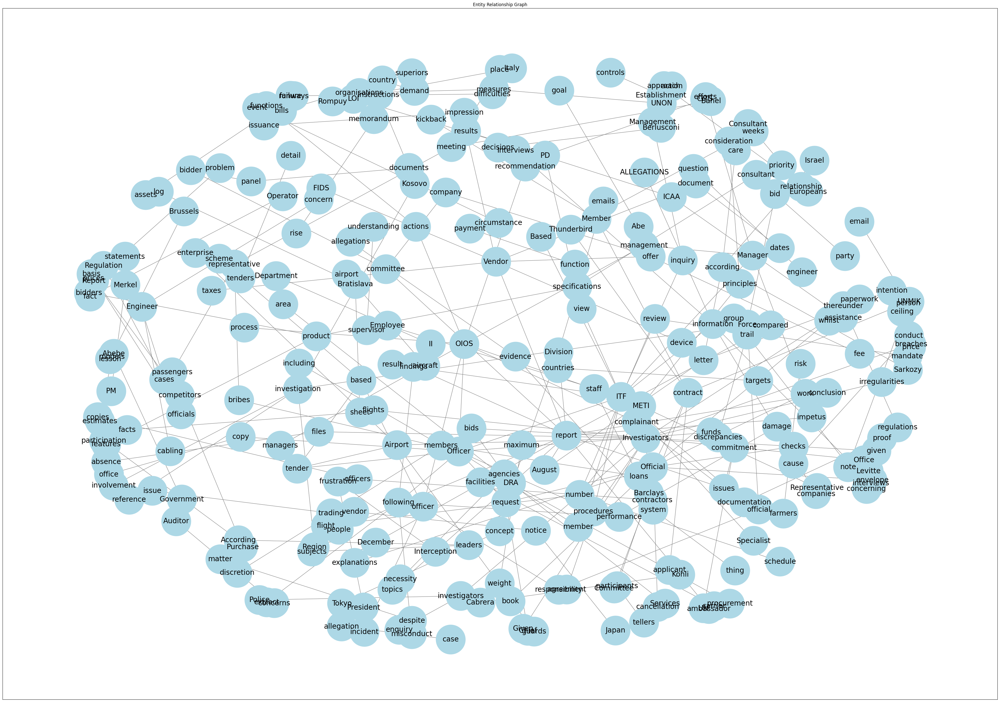

relationship_graph.html


In [80]:

import networkx as nx
import matplotlib.pyplot as plt
from pyvis.network import Network

G = nx.Graph()

# Process each row in the column
for text in wiki_df['text_cleaned']:
    if isinstance(text, str):  # Ensure the entry is a string
        doc = nlp(text)
        for sent in doc.sents:
            
            relationships = extract_relationships(sent)
            
            # Filter relationships to retain only meaningful ones
            meaningful_relationships = filter_meaningful_relationships(relationships)
            
            
            for subject, verb, obj in meaningful_relationships:
                        # Add the relationship as an edge between subject and object
                        G.add_edge(subject, obj, label=verb)
            

# Remove self-loops if any
G.remove_edges_from(nx.selfloop_edges(G))

nodes_to_remove = [node for node, degree in dict(G.degree()).items() if degree == 0]
G.remove_nodes_from(nodes_to_remove)


# Draw the graph

pos = nx.spring_layout(G, k = 0.7 , iterations = 100)  # a force-directed layout
plt.figure(figsize=(50, 35))

nx.draw_networkx(
    G,
    pos,
    with_labels=True,  # Display node labels
    node_color="lightblue",  # Node color
    edge_color="gray",  # Edge color
    font_size=20,  # Font size for labels
    node_size=6800,  # Node size
)
plt.title("Entity Relationship Graph")  
plt.show()

# PyVis interactive graph
net = Network(notebook=True)
net.from_nx(G)
net.show("relationship_graph.html")


In [81]:
# Calculate centrality
degree_centrality = nx.degree_centrality(G)
betweenness_centrality = nx.betweenness_centrality(G)
pagerank = nx.pagerank(G)

# top 5 most important nodes
top_nodes = sorted(pagerank, key=pagerank.get, reverse=True)[:5]
print("Top influential nodes:", top_nodes)

Top influential nodes: ['ITF', 'report', 'Investigators', 'Official', 'Officer']
